In [1]:
import sys
import os

# Add the folder containing your modules to the Python path
sys.path.append(os.path.abspath('/Users/yashwanthr/Downloads/my_project1'))

# Import custom modules
from commonfunctions import *
from pre_processing import *
from staff import calculate_thickness_spacing, remove_staff_lines, coordinator
from segmenter import Segmenter
from connected_componentes import *
from box import Box

# Import standard libraries
import glob
import cv2
import pickle
from imutils import resize as im_resize
from scipy.ndimage import binary_fill_holes
from skimage.morphology import skeletonize, thin

# Proceed with your code...


In [2]:
img_name = 'love'
img_ext = 'jpg'
imgs_path = '../yashwanthr/Downloads/'

In [3]:
from skimage import io


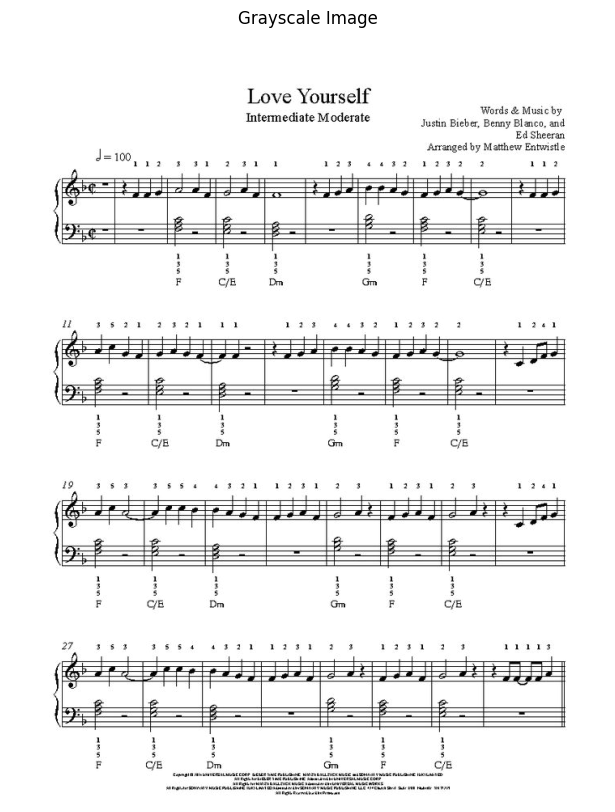

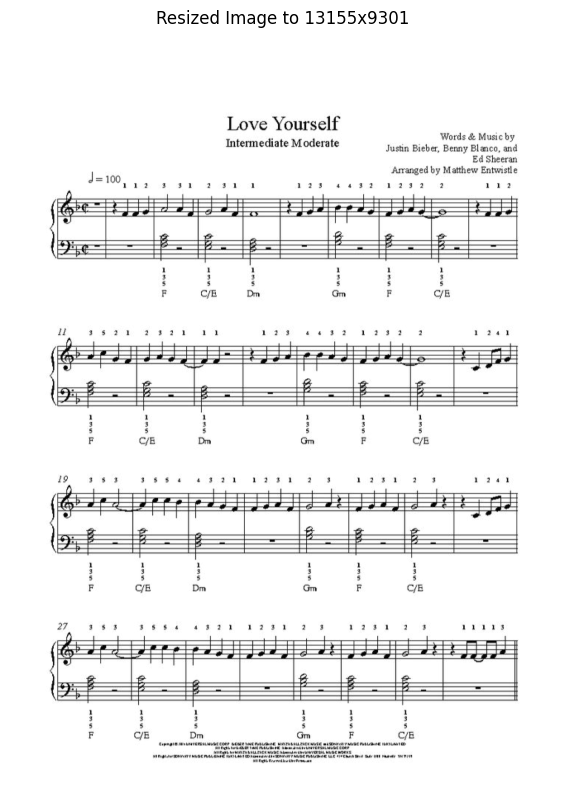

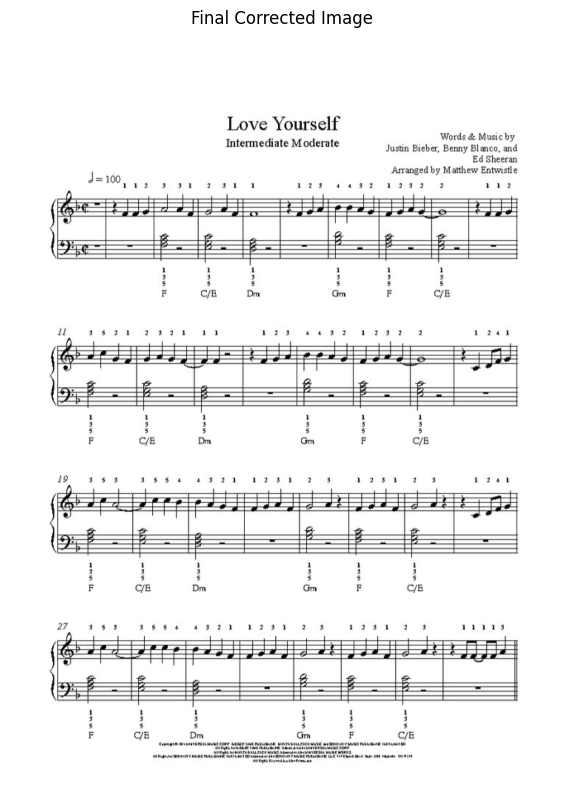

In [4]:
import cv2
from skimage.color import rgb2gray
import numpy as np
import matplotlib.pyplot as plt
from skimage import io
from skimage.filters import threshold_otsu

# Function to convert to grayscale if needed
def gray_img(img):
    """Convert image to grayscale if it has more than one channel."""
    if len(img.shape) == 3:  # If the image has 3 channels (RGB)
        return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img  # If already grayscale, return as is

# Function to display images
def show_images(images, titles=None):
    """Display a list of images."""
    n = len(images)
    plt.figure(figsize=(20, 10))
    
    for i, img in enumerate(images):
        plt.subplot(1, n, i + 1)
        if len(img.shape) == 2:  # Grayscale image
            plt.imshow(img, cmap='gray')
        else:  # RGB image
            plt.imshow(img)
        if titles:
            plt.title(titles[i])
        plt.axis('off')
    plt.show()

# Function to resize and pad the image to a uniform size
def resize_with_aspect_ratio(img, target_size=(13155, 9301)):
    """Resize image while keeping the aspect ratio intact and pad to the target size."""
    h, w = img.shape[:2]
    target_h, target_w = target_size

    # Calculate the scaling factor to fit within the target size
    scale = min(target_w / w, target_h / h)

    # Resize the image with the calculated scaling factor
    new_w, new_h = int(w * scale), int(h * scale)
    resized_img = cv2.resize(img, (new_w, new_h))

    # Create a new image with the target size and center the resized image
    padded_img = np.ones((target_h, target_w), dtype=np.uint8) * 255  # Create a white canvas
    y_offset = (target_h - new_h) // 2
    x_offset = (target_w - new_w) // 2
    padded_img[y_offset:y_offset + new_h, x_offset:x_offset + new_w] = resized_img

    return padded_img

# Function to check if the image is horizontal (dummy implementation)
def IsHorizontal(img):
    """Dummy function to check if image is horizontal."""
    return True  # Assume it's horizontal for now

# Function to deskew an image (dummy implementation)
def deskew(img):
    """Dummy function for deskewing."""
    return 0  # Assume no rotation required

# Function to rotate an image by a certain angle
def rotation(img, theta):
    """Rotate image by the given angle theta."""
    (h, w) = img.shape[:2]
    center = (w // 2, h // 2)

    # Perform the rotation
    M = cv2.getRotationMatrix2D(center, theta, 1.0)
    rotated = cv2.warpAffine(img, M, (w, h))
    return rotated

# Function to threshold the image
def get_thresholded(img, thresh_value):
    """Apply thresholding to the image."""
    _, thresh_img = cv2.threshold(img, thresh_value, 255, cv2.THRESH_BINARY)
    return thresh_img

# Function to apply closing operation
def get_closer(img):
    """Apply closing (dilation followed by erosion) to the image."""
    kernel = np.ones((5,5), np.uint8)
    closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
    return closing



# Read and process the image
img_path = f'{imgs_path}{img_name}.{img_ext}'
img = io.imread(img_path)
img = gray_img(img)

# Display the grayscale image
show_images([img], titles=["Grayscale Image"])

# Check if the image is horizontal, otherwise deskew and adjust it
horizontal = IsHorizontal(img)
if not horizontal:
    theta = deskew(img)
    img = rotation(img, theta)
    img = gray_img(img)  # Convert image back to grayscale if needed
    img = get_thresholded(img, threshold_otsu(img))  # Apply Otsu's thresholding
    img = get_closer(img)  # Apply closing to clean up the image
    horizontal = IsHorizontal(img)  # Check again if it's horizontal after corrections

# Resize and pad the image to the large size (13155, 9301)
img_resized = resize_with_aspect_ratio(img)

# Display the resized image
show_images([img_resized], titles=["Resized Image to 13155x9301"])

# Display the final corrected image (if any changes were applied)
show_images([img_resized], titles=["Final Corrected Image"])


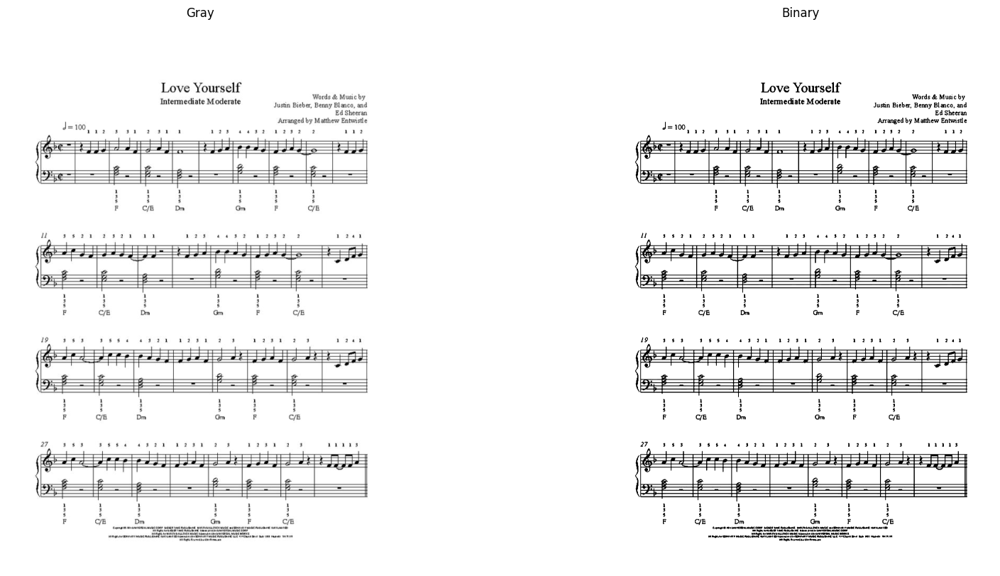

In [5]:
# Save the original resized image and create binary image
original = img_resized.copy()  # Use the resized image

# Convert to grayscale if needed (using gray_img function)
gray = gray_img(original)  

# Apply Otsu's thresholding to convert to binary
bin_img = get_thresholded(gray, threshold_otsu(gray))

# Display the grayscale and binary images
show_images([gray, bin_img], ['Gray', 'Binary'])


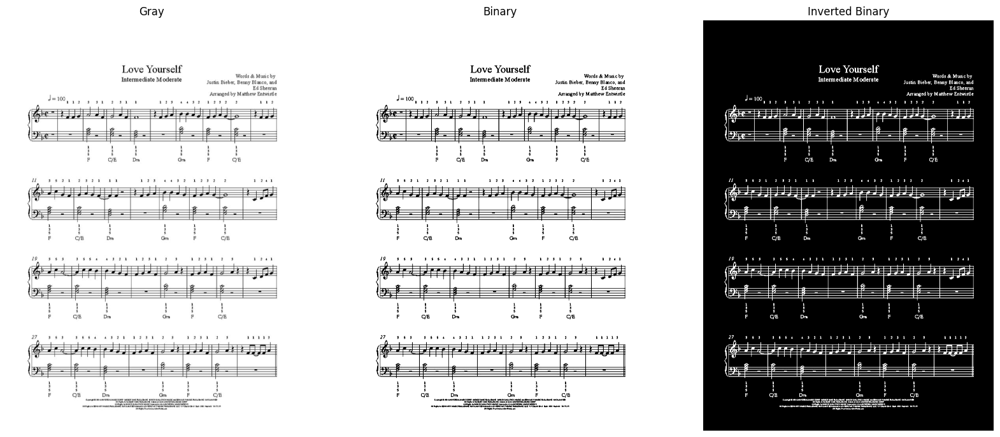

In [6]:
# Save the original resized image and create a binary image
original = img_resized.copy()  # Use the resized image

# Convert to grayscale if needed (using gray_img function)
gray = gray_img(original)

# Apply Otsu's thresholding to convert to binary
bin_img = get_thresholded(gray, threshold_otsu(gray))

# Invert the binary image if necessary (assuming black staff lines and white background)
bin_img_inverted = cv2.bitwise_not(bin_img)  # Invert colors (white -> black, black -> white)

# Display the grayscale, binary, and inverted binary images
show_images([gray, bin_img, bin_img_inverted], ['Gray', 'Binary', 'Inverted Binary'])


/var/folders/0w/skl0whlx02x81_w1rjc9m4n00000gn/T/ipykernel_43880/2161627004.py:24: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(img, cmap='gray')


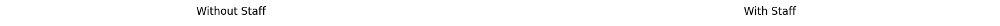

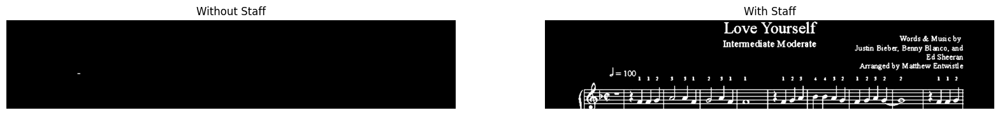

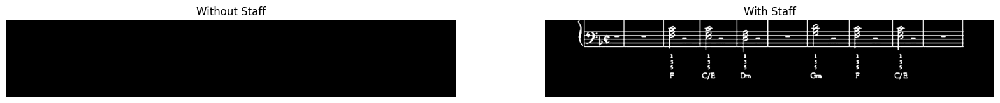

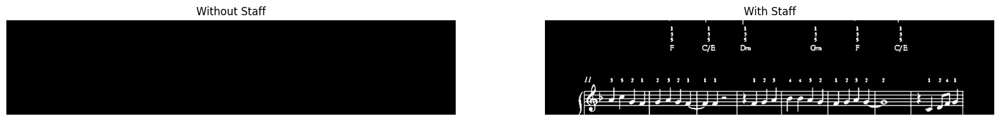

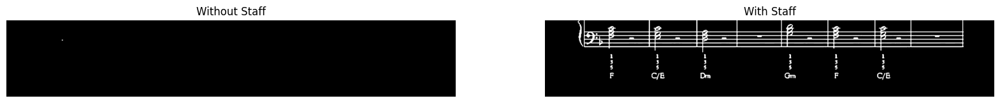

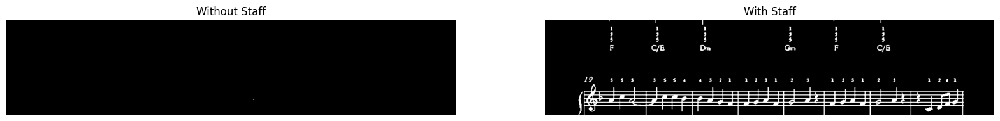

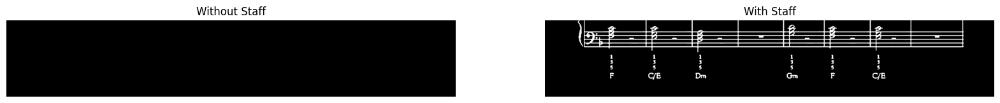

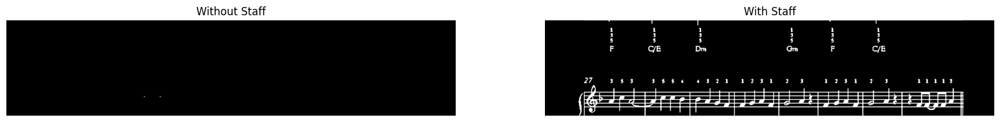

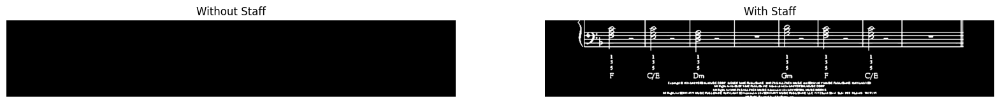

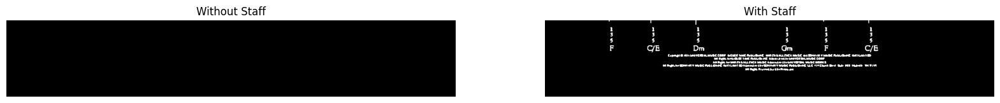

In [7]:
# Ensure that the Segmenter class is defined
# Assume it takes a binary image and segments it into regions with and without staff lines

# Segment the musical sheet (using the inverted binary image)
segmenter = Segmenter(bin_img_inverted)  # Pass the inverted binary image for segmentation

# Assuming the segmenter outputs two lists of images:
imgs_with_staff = segmenter.regions_with_staff
imgs_without_staff = segmenter.regions_without_staff

# Check that both lists have the same length before displaying
if len(imgs_with_staff) == len(imgs_without_staff):
    # Display the segmented parts with and without staff lines
    for i in range(len(imgs_without_staff)):
        show_images([imgs_without_staff[i], imgs_with_staff[i]], titles=['Without Staff', 'With Staff'])
else:
    print("Mismatch in the number of segmented images with and without staff lines.")


/var/folders/0w/skl0whlx02x81_w1rjc9m4n00000gn/T/ipykernel_43880/2161627004.py:24: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(img, cmap='gray')


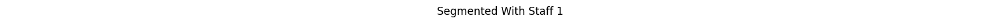

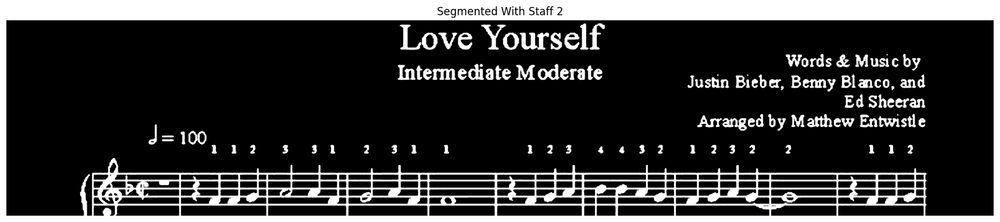

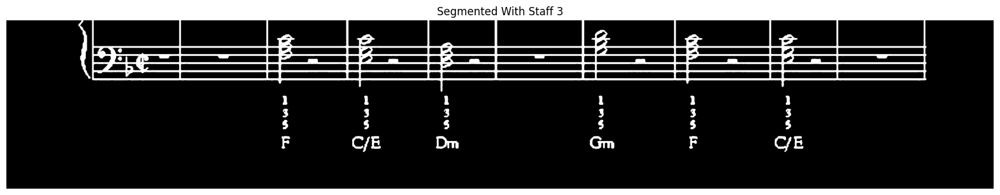

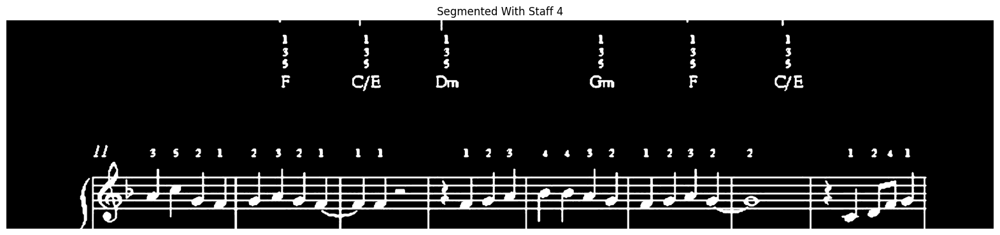

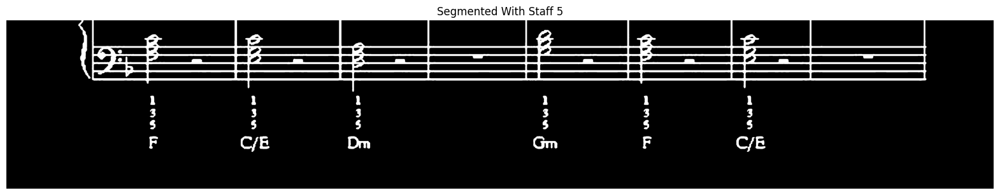

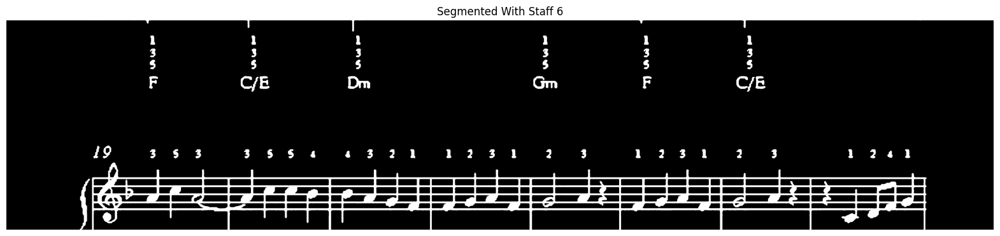

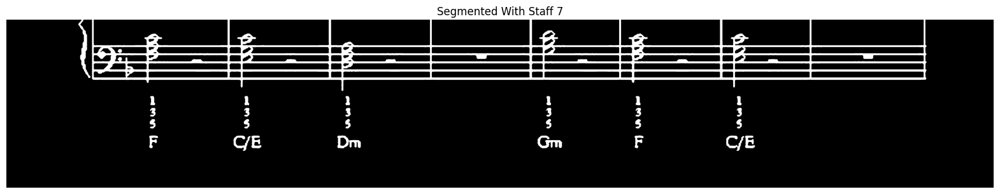

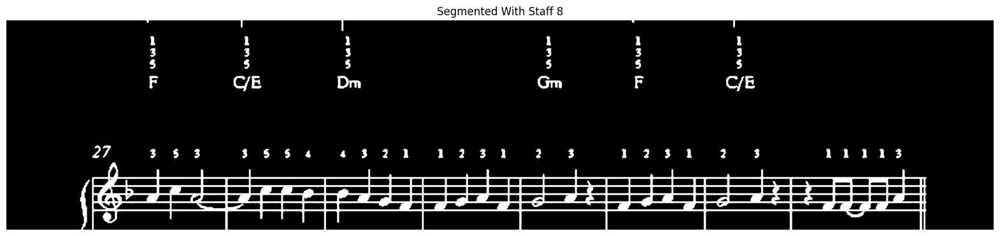

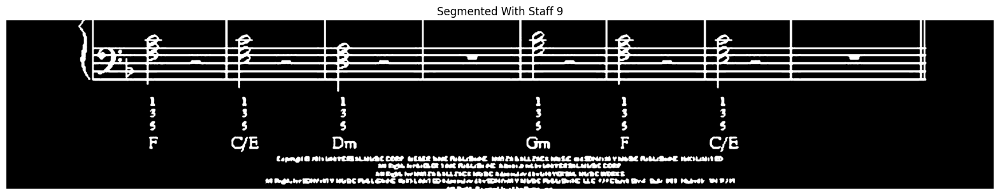

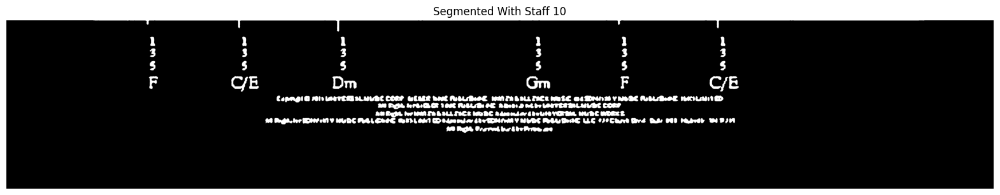

In [8]:
# Display the segmented parts that contain staff lines only
for i, img_with_staff in enumerate(imgs_with_staff):
    show_images([img_with_staff], titles=[f"Segmented With Staff {i + 1}"])


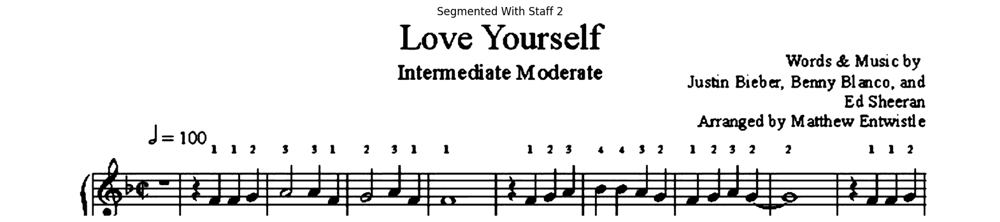

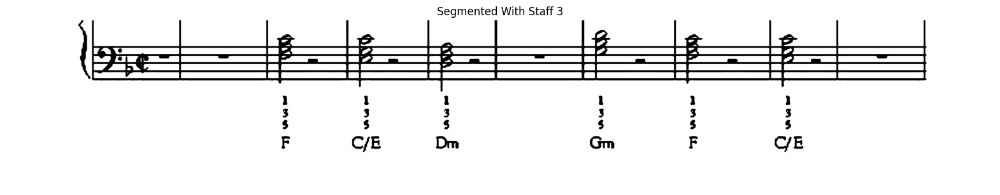

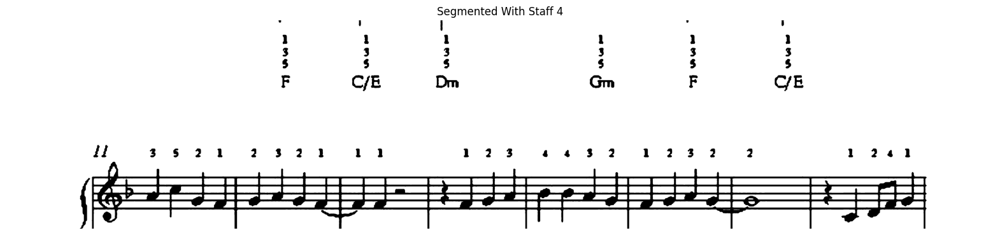

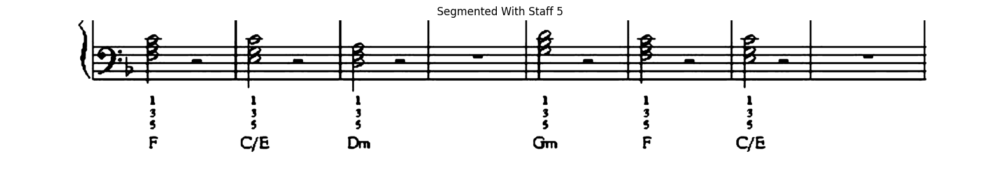

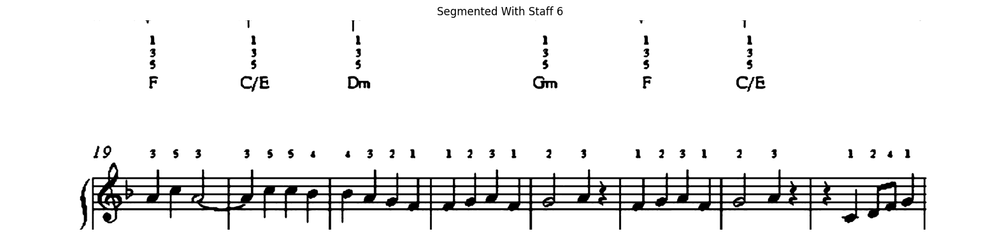

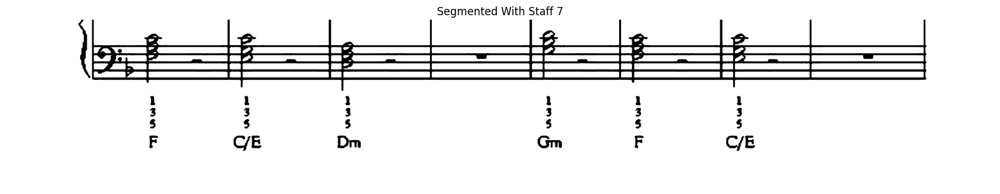

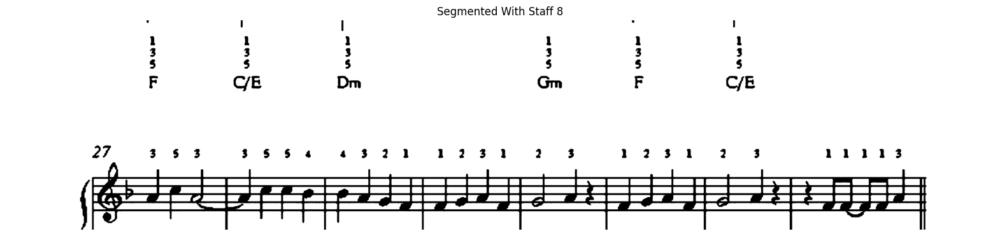

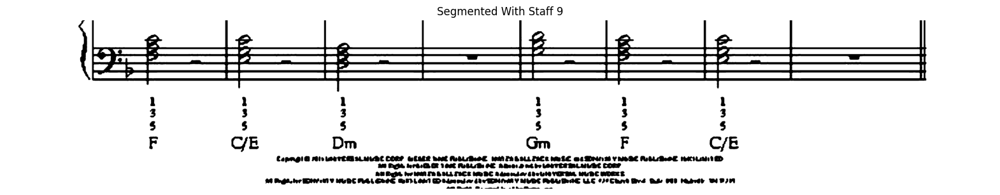

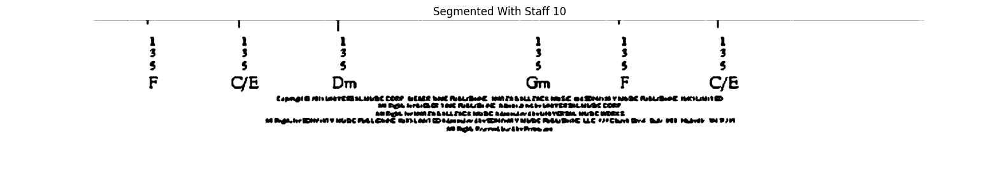

In [9]:
# Display the segmented parts with staff only, after inverting colors
for i, img_with_staff in enumerate(imgs_with_staff):
    if img_with_staff is not None:  # Check if the image is valid
        # Invert the colors of the segmented image
        img_with_staff_inverted = cv2.bitwise_not(img_with_staff)
        
        if img_with_staff_inverted is not None:  # Ensure inversion is successful
            # Show the inverted segmented image
            show_images([img_with_staff_inverted], titles=[f"Segmented With Staff {i + 1}"])
        else:
            print(f"Warning: Inversion failed for imgs_with_staff[{i}].")
    else:
        print(f"Warning: imgs_with_staff[{i}] is None.")


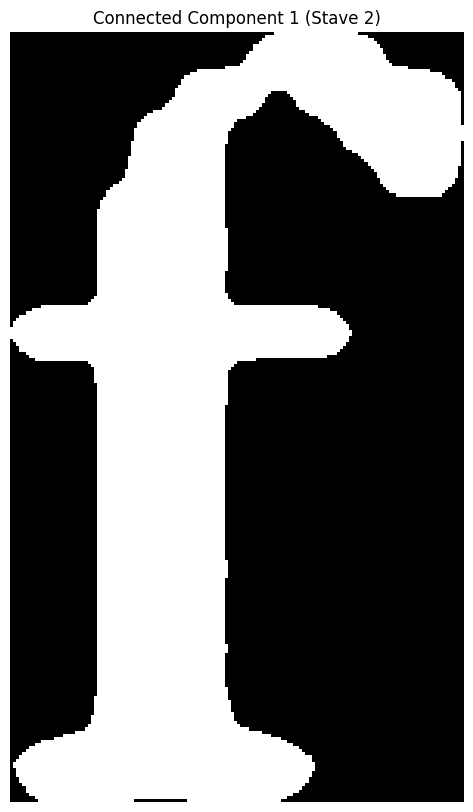

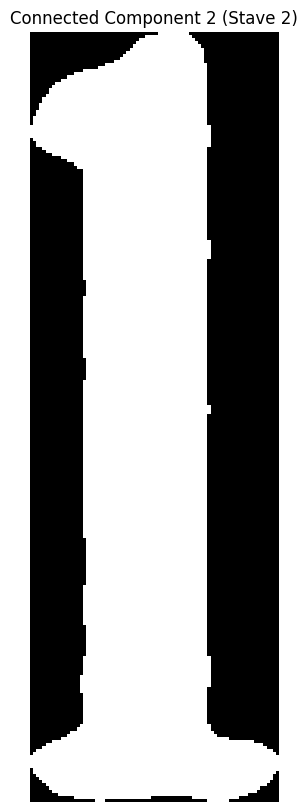

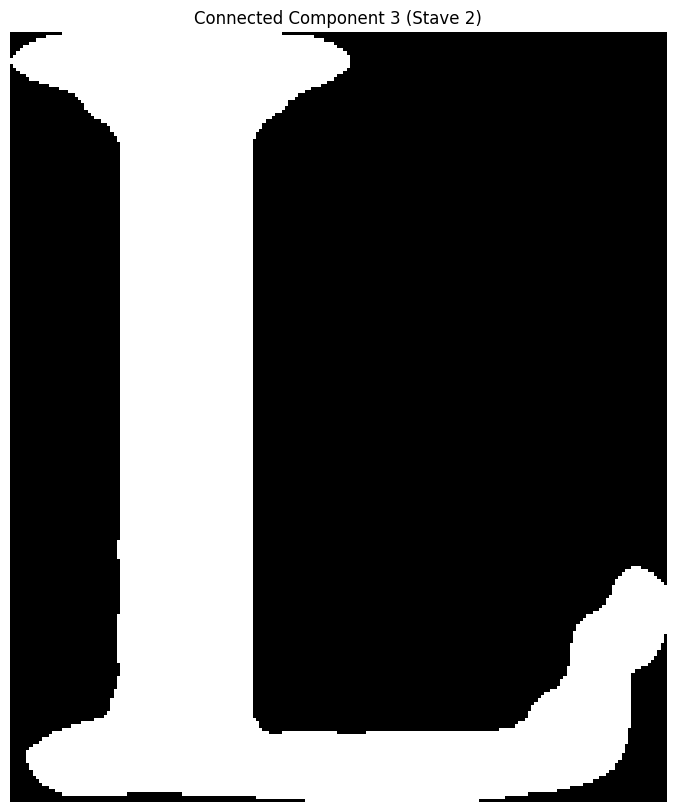

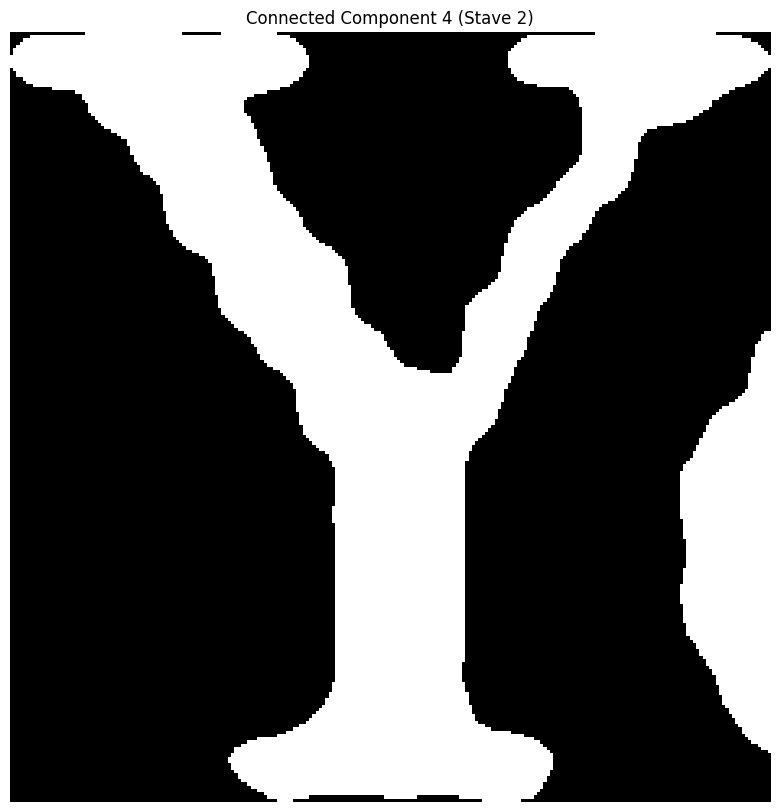

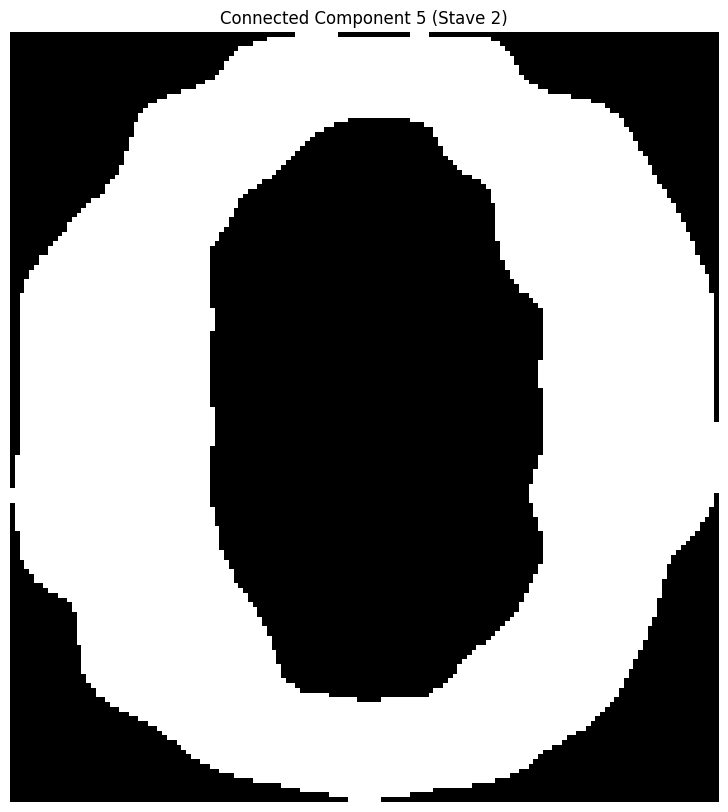

...

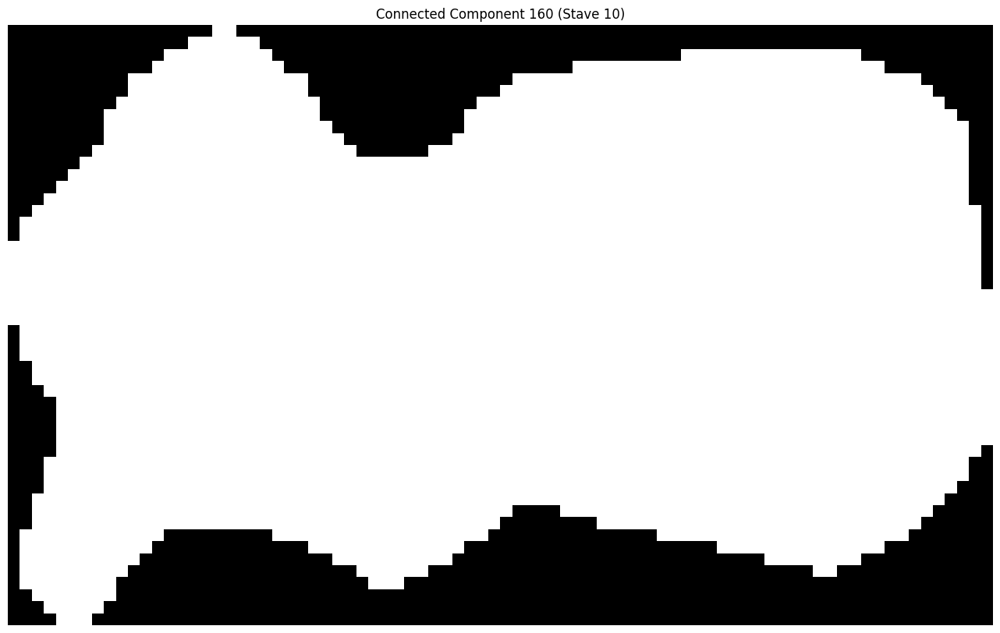

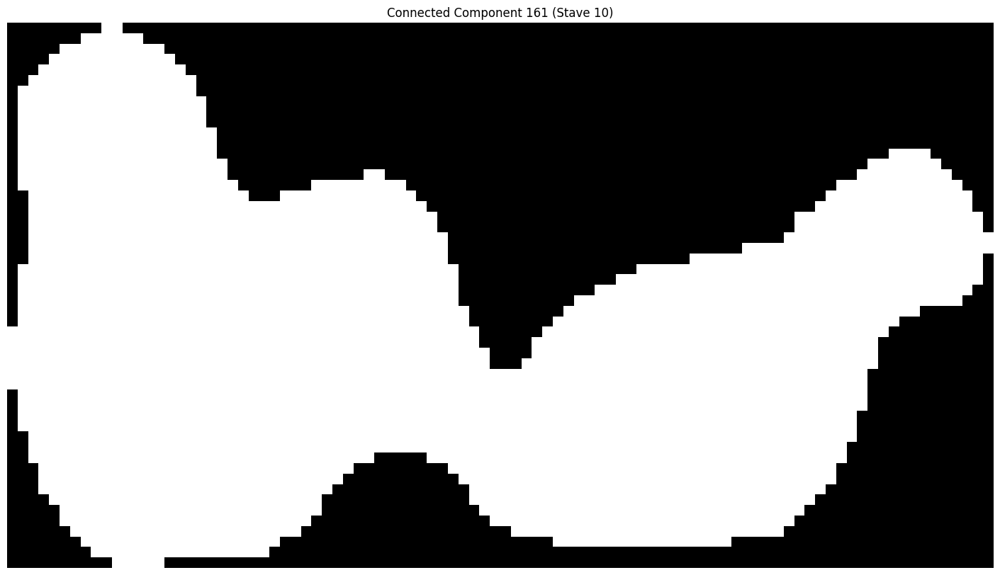

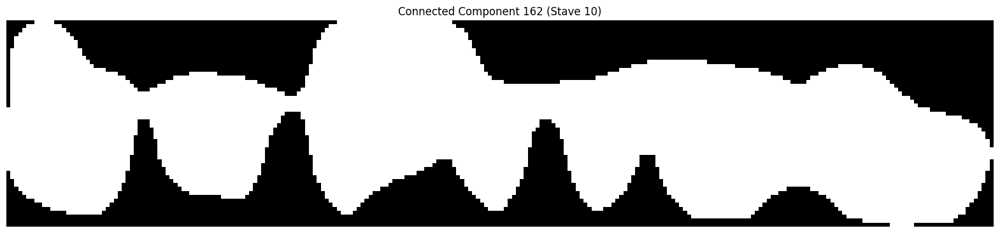

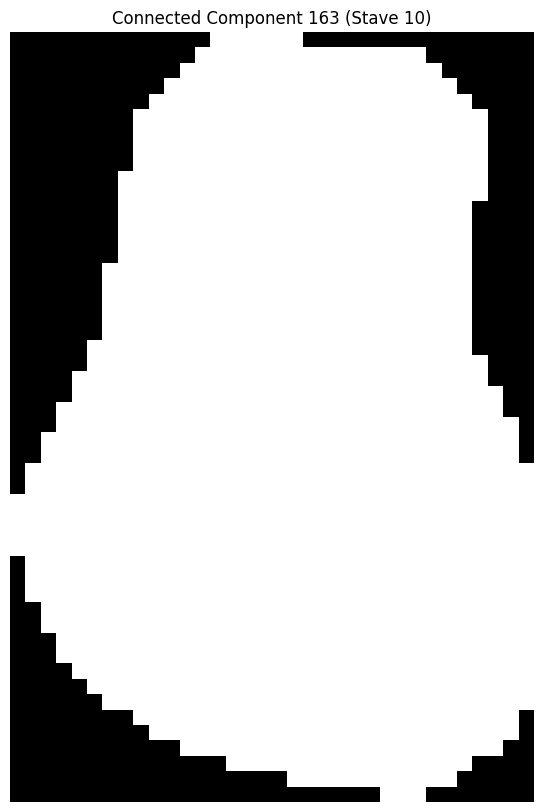

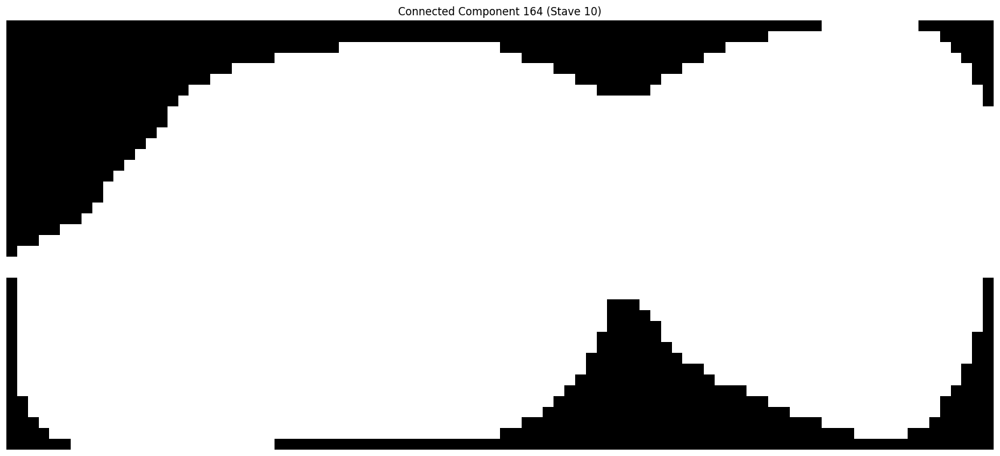

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops

def preprocess_image(image):
    """Preprocess the image to enhance the extraction of connected components."""
    # Apply Gaussian Blur
    blurred = cv2.GaussianBlur(image, (5, 5), 0)

    # Thresholding to create a binary image
    _, binary = cv2.threshold(blurred, 127, 255, cv2.THRESH_BINARY_INV)  # Inverting for black foreground
    
    # Apply morphological operations to clean up the image
    kernel = np.ones((3, 3), np.uint8)
    morphed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    
    return morphed

def extract_connected_components(image):
    """Extract connected components from a binary image."""
    # Label connected components
    labeled_img = label(image, connectivity=2)
    components = []

    # Loop through the labeled regions
    for region in regionprops(labeled_img):
        min_row, min_col, max_row, max_col = region.bbox
        
        # Extract the component using the bounding box
        component = image[min_row:max_row, min_col:max_col]
        
        components.append(component)

    return components

# Display the segmented parts with staff only, inverting colors first
for i, img_with_staff in enumerate(imgs_with_staff):
    if img_with_staff is not None:  # Check if the image is valid
        # Invert the colors of the segmented image
        img_with_staff_inverted = cv2.bitwise_not(img_with_staff)

        if img_with_staff_inverted is not None:  # Ensure inversion is successful
            # Preprocess the inverted image
            processed_image = preprocess_image(img_with_staff_inverted)

            # Extract connected components
            connected_components = extract_connected_components(processed_image)

            # Display each connected component as a separate image
            for j, component in enumerate(connected_components):
                show_images([component], titles=[f"Connected Component {j + 1} (Stave {i + 1})"])
        else:
            print(f"Warning: Inversion failed for imgs_with_staff[{i}].")
    else:
        print(f"Warning: imgs_with_staff[{i}] is None.")


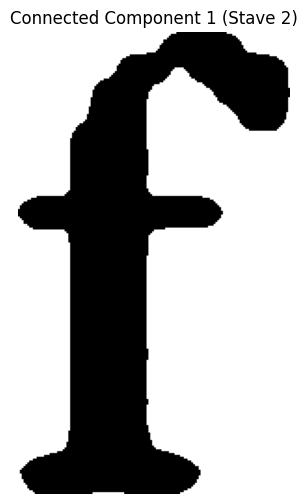

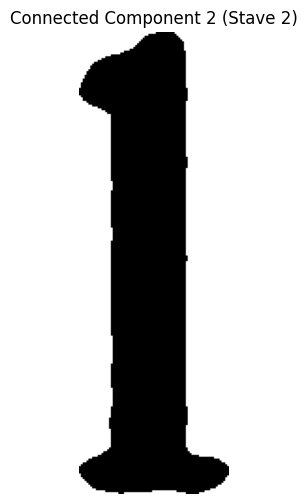

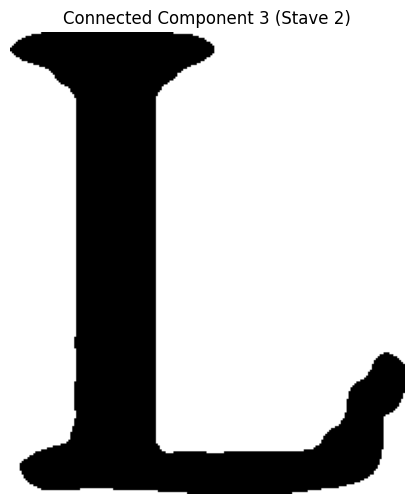

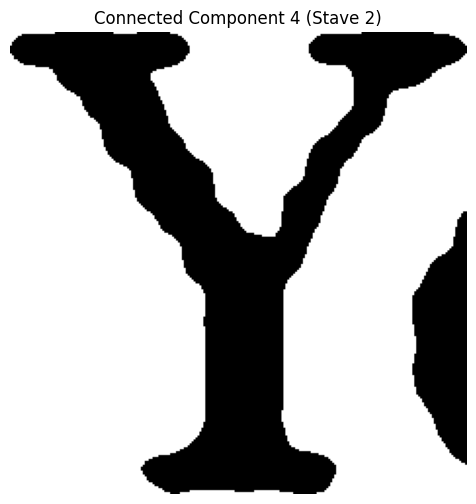

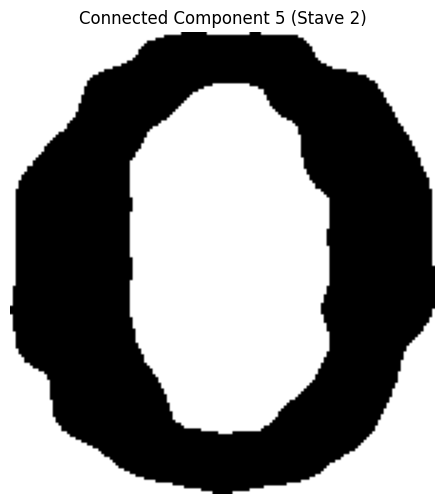

...

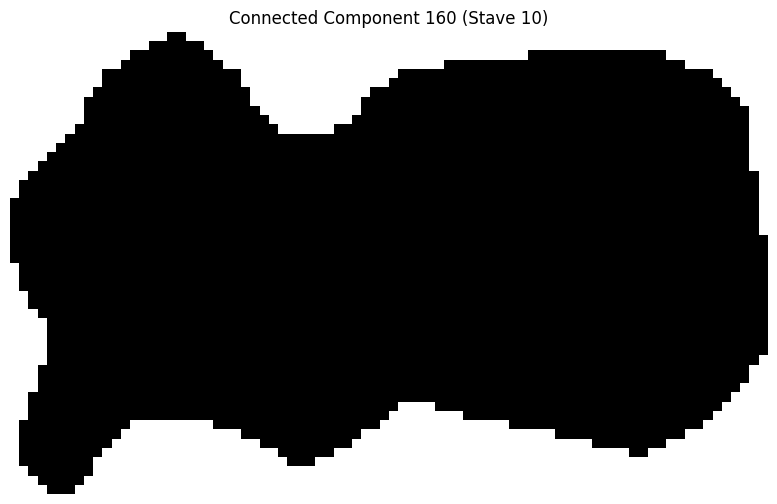

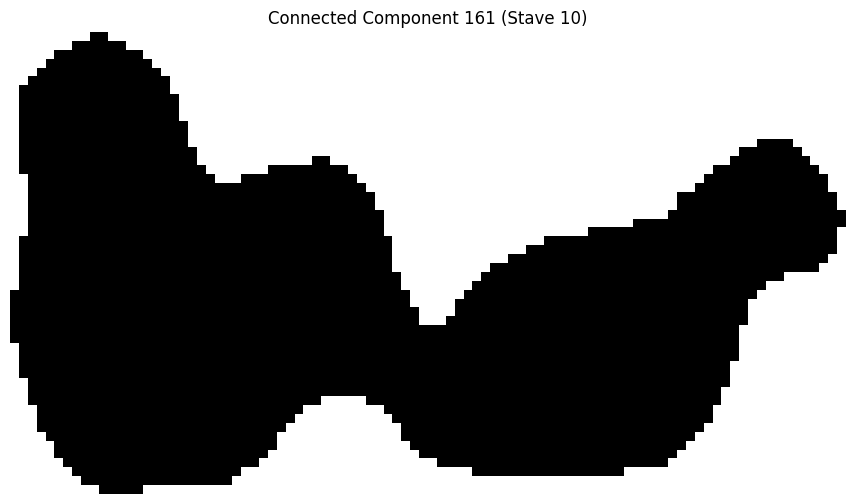

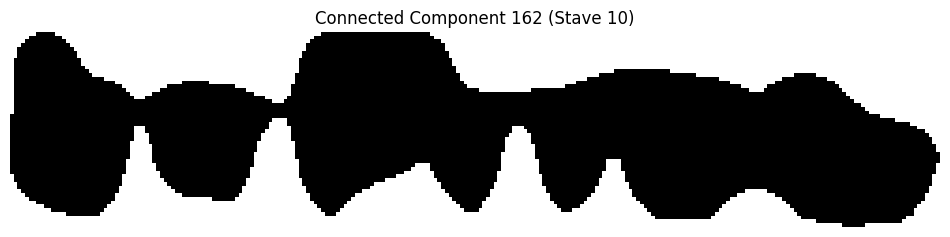

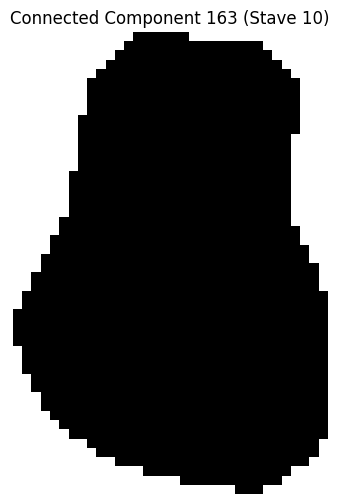

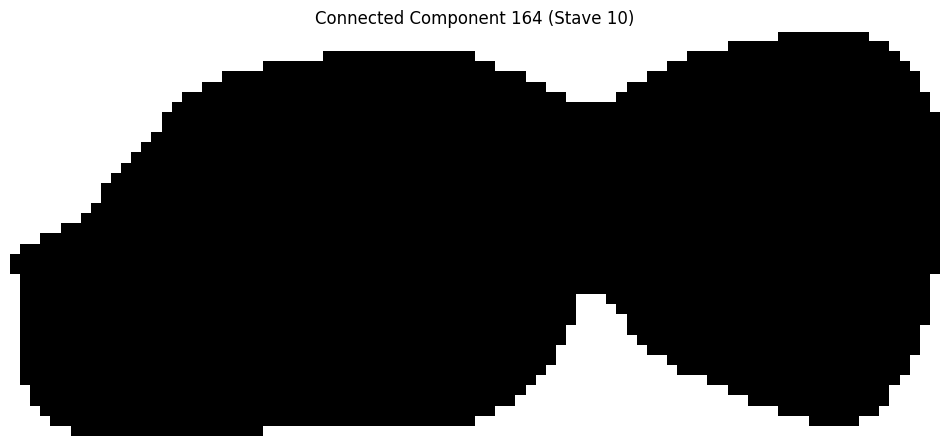

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import label, regionprops

def preprocess_image(image):
    """Preprocess the image to enhance the extraction of connected components."""
    # Apply Gaussian Blur
    blurred = cv2.GaussianBlur(image, (5, 5), 0)

    # Thresholding to create a binary image
    _, binary = cv2.threshold(blurred, 127, 255, cv2.THRESH_BINARY_INV)  # Inverting for black foreground
    
    # Apply morphological operations to clean up the image
    kernel = np.ones((3, 3), np.uint8)
    morphed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    
    return morphed

def extract_connected_components(image):
    """Extract connected components from a binary image."""
    # Label connected components
    labeled_img = label(image, connectivity=2)
    components = []

    # Loop through the labeled regions
    for region in regionprops(labeled_img):
        min_row, min_col, max_row, max_col = region.bbox
        
        # Extract the component using the bounding box
        component = image[min_row:max_row, min_col:max_col]
        
        components.append(component)

    return components

def show_images(images, titles=None):
    """Utility function to display images with titles in inverted colors."""
    plt.figure(figsize=(12, 6))
    for i, img in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        
        # Invert the image colors for display
        img_inverted = cv2.bitwise_not(img)  # Invert colors for display
        
        plt.imshow(img_inverted, cmap='gray')
        if titles is not None:
            plt.title(titles[i])
        plt.axis('off')
    plt.show()

# Display the segmented parts with staff only, inverting colors first
for i, img_with_staff in enumerate(imgs_with_staff):
    if img_with_staff is not None:  # Check if the image is valid
        # Invert the colors of the segmented image
        img_with_staff_inverted = cv2.bitwise_not(img_with_staff)

        if img_with_staff_inverted is not None:  # Ensure inversion is successful
            # Preprocess the inverted image
            processed_image = preprocess_image(img_with_staff_inverted)

            # Extract connected components
            connected_components = extract_connected_components(processed_image)

            # Display each connected component as a separate image
            for j, component in enumerate(connected_components):
                show_images([component], titles=[f"Connected Component {j + 1} (Stave {i + 1})"])
        else:
            print(f"Warning: Inversion failed for imgs_with_staff[{i}].")
    else:
        print(f"Warning: imgs_with_staff[{i}] is None.")


In [12]:
import cv2
import numpy as np
import os
from skimage.measure import label, regionprops



# Define the folder path dynamically based on the image name
save_folder = os.path.join(imgs_path, f'connected_components_{img_name}')
os.makedirs(save_folder, exist_ok=True)  # Create the folder if it doesn't exist

def preprocess_image(image):
    """Preprocess the image to enhance the extraction of connected components."""
    # Apply Gaussian Blur
    blurred = cv2.GaussianBlur(image, (5, 5), 0)

    # Thresholding to create a binary image
    _, binary = cv2.threshold(blurred, 127, 255, cv2.THRESH_BINARY_INV)  # Inverting for black foreground
    
    # Apply morphological operations to clean up the image
    kernel = np.ones((3, 3), np.uint8)
    morphed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    
    return morphed

def extract_connected_components(image):
    """Extract connected components from a binary image."""
    # Label connected components
    labeled_img = label(image, connectivity=2)
    components = []

    # Loop through the labeled regions
    for region in regionprops(labeled_img):
        min_row, min_col, max_row, max_col = region.bbox
        
        # Extract the component using the bounding box
        component = image[min_row:max_row, min_col:max_col]
        
        components.append(component)

    return components

# Display and save the segmented parts with staff only, inverting colors first
counter = 1  # Initialize a counter for naming the files
for i, img_with_staff in enumerate(imgs_with_staff):
    if img_with_staff is not None:  # Check if the image is valid
        # Invert the colors of the segmented image
        img_with_staff_inverted = cv2.bitwise_not(img_with_staff)

        if img_with_staff_inverted is not None:  # Ensure inversion is successful
            # Preprocess the inverted image
            processed_image = preprocess_image(img_with_staff_inverted)

            # Extract connected components
            connected_components = extract_connected_components(processed_image)

            # Save each connected component as displayed
            for j, component in enumerate(connected_components):
                # Invert the colors back to match display output
                component_inverted = cv2.bitwise_not(component)
                
                # Save the inverted component with sequential naming (e.g., 1.jpg, 2.jpg, etc.)
                file_name = f"{counter}.jpg"  # Sequential file names like 1.jpg, 2.jpg, etc.
                file_path = os.path.join(save_folder, file_name)
                cv2.imwrite(file_path, component_inverted)
                counter += 1  # Increment counter for the next component
        else:
            print(f"Warning: Inversion failed for imgs_with_staff[{i}].")
    else:
        print(f"Warning: imgs_with_staff[{i}] is None.")


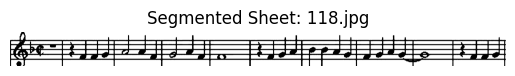

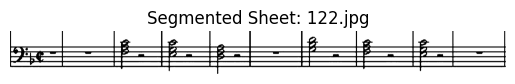

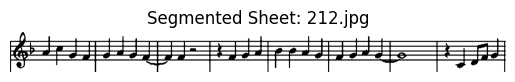

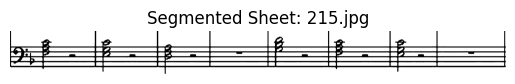

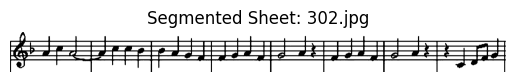

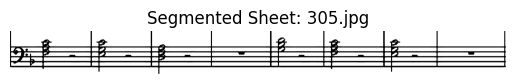

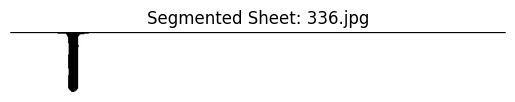

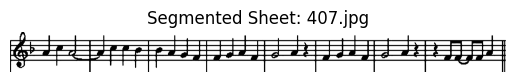

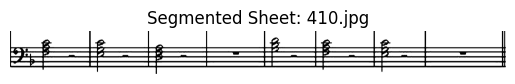

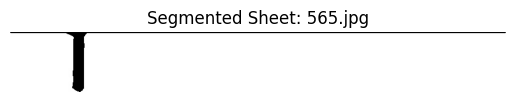

Displayed and saved all segmented sheets in '/Users/yashwanthr/Downloads/segmented_images_love'.


In [13]:
import cv2
import os
import matplotlib.pyplot as plt
import re

# Inputs provided by the user
img_name = 'love'  # Base name for the image

# Directory containing the input images
folder_path = f"/Users/yashwanthr/Downloads/connected_components_{img_name}"

# Directory to save the segmented images, automatically named based on img_name
output_folder = f"/Users/yashwanthr/Downloads/segmented_images_{img_name}"
os.makedirs(output_folder, exist_ok=True)  # Create the output folder if it does not exist

# Threshold dimensions to differentiate between full segmented sheets and extracted components
min_width = 500  # Adjust this threshold based on your sheet size
min_height = 100  # Adjust this threshold based on your sheet size

# Lists to store the paths of segmented sheets and components
segmented_sheets = []
components = []

# Function to extract numeric value from filenames for sorting
def extract_number(filename):
    match = re.search(r'\d+', filename)  # Extract the first sequence of digits found
    return int(match.group()) if match else float('inf')  # Assign large value if no digits are found

# Iterate through each file in the folder
for filename in os.listdir(folder_path):
    file_path = os.path.join(folder_path, filename)
    
    # Read the image
    image = cv2.imread(file_path)
    if image is None:
        continue
    
    # Get the dimensions of the image
    height, width = image.shape[:2]
    
    # Check if the image meets the criteria for a segmented musical sheet
    if width >= min_width and height >= min_height:
        segmented_sheets.append(file_path)
    else:
        components.append(file_path)

# Sort the segmented sheets numerically based on extracted numbers in filenames
segmented_sheets.sort(key=lambda x: extract_number(os.path.basename(x)))

# Save and display the segmented sheets in numerical order
for i, sheet in enumerate(segmented_sheets, 1):
    image = cv2.imread(sheet)
    if image is not None:
        # Convert BGR image (OpenCV format) to RGB format for displaying in matplotlib
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Save the segmented image to the output folder with sequential naming like 1.jpg, 2.jpg, etc.
        output_path = os.path.join(output_folder, f"{i}.jpg")
        cv2.imwrite(output_path, image)  # Save the original BGR image

        # Display the image with matplotlib (optional)
        plt.imshow(image_rgb)
        plt.axis('off')  # Hide the axes
        plt.title(f"Segmented Sheet: {os.path.basename(sheet)}")  # Display filename as title
        plt.show()  # Display the image

print(f"Displayed and saved all segmented sheets in '{output_folder}'.")


Processed 1.jpg, Prediction: clef-G2
	
keySignature-FM
	
timeSignature-C/
	
rest-whole
	
barline
	
note-G4_eighth
	
note-F4_eighth
	
note-F4_eighth
	
note-G4_eighth
	
barline
	
note-A4_quarter
	
note-A4_eighth
	
note-F4_eighth
	
barline
	
note-G4_quarter
	
note-A4_eighth
	
note-F4_eighth
	
barline
	
note-F4_whole
	
barline
	
note-G4_eighth
	
note-F4_eighth
	
note-G4_eighth
	
note-A4_eighth
	
barline
	
note-Bb4_eighth
	
note-Bb4_eighth
	
note-A4_eighth
	
note-G4_eighth
	
barline
	
note-F4_eighth
	
note-G4_eighth
	
note-A4_eighth
	
note-G4_eighth
	
barline
	
note-G4_quarter
	
barline
	
note-G4_eighth
	
note-F4_eighth
	
note-F4_eighth
	
note-G4_eighth
	
barline
ABC Format:
%%clef G
K:F
C
R/1
|
G4/8
F4/8
F4/8
G4/8
|
A4/4
A4/8
F4/8
|
G4/4
A4/8
F4/8
|
F4/1
|
G4/8
F4/8
G4/8
A4/8
|
Bb4/8
Bb4/8
A4/8
G4/8
|
F4/8
G4/8
A4/8
G4/8
|
G4/4
|
G4/8
F4/8
F4/8
G4/8
|
Processed 2.jpg, Prediction: clef-F4
	
keySignature-FM
	
timeSignature-C/
	
rest-whole
	
rest-whole
	
barline
	
clef-C4
	
rest-half
	
barlin

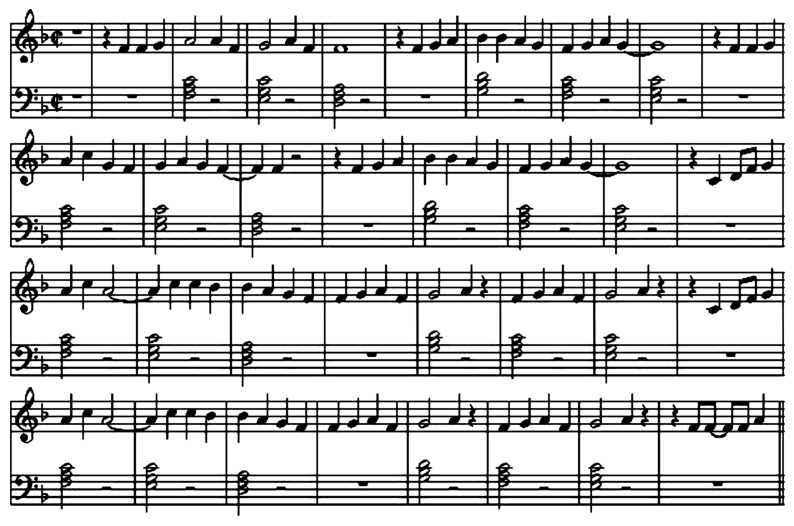

In [14]:
import os
import subprocess
import cv2
import re
import numpy as np
from matplotlib import pyplot as plt

# Define paths
test_folder = f"/Users/yashwanthr/Downloads/segmented_images_{img_name}"  # Folder with connected components
ctc_predict_path = '/Users/yashwanthr/Downloads/tf-end-to-end-master/ctc_predict.py'  # Full path to the script
abc_notation_path = '/Users/yashwanthr/Downloads/abc_notation.txt'  # Path to ABC notation file

# Threshold for minimal representation (can be tuned)
min_representation_length = 3  # Define a threshold for valid prediction length (e.g., at least 3 elements)

# Initialize lists to store predictions and valid image paths
predictions = []
valid_image_paths = []

# Load ABC notation into a dictionary
abc_dict = {}
with open(abc_notation_path, 'r') as abc_file:
    for line in abc_file:
        if ':' in line:
            text_representation, abc_format = line.strip().split(':', 1)
            abc_dict[text_representation.strip()] = abc_format.strip()

# Retrieve and sort the filenames in the connected_components folder
image_files = [f for f in os.listdir(test_folder) if f.endswith('.jpg')]

# Sort the image files numerically based on the extracted numbers from filenames
def extract_component_number(filename):
    match = re.search(r'(\d+)', filename)  # Extract numbers from filenames
    return int(match.group(1)) if match else float('inf')  # Return 'inf' if no match found

image_files.sort(key=extract_component_number)  # Sort files based on the numeric part

# Limit the number of files to parse
max_files_to_parse = 150  # Set your desired limit here
image_files = image_files[:max_files_to_parse]  # Slice the list to the desired number

# Iterate through the image files and run the model
for image_file in image_files:
    image_path = os.path.join(test_folder, image_file)
    
    # Check if the image is readable
    image = cv2.imread(image_path)
    if image is None:
        print(f"Skipped unreadable file: {image_file}")
        continue  # Skip the current iteration if the image is not valid

    model_path = '/Users/yashwanthr/Downloads/Semantic-Model 2/semantic_model.meta'
    vocabulary_path = '/Users/yashwanthr/Downloads/tf-end-to-end-master/Data/vocabulary_semantic.txt'

    # Construct the command
    command = [
        'python3', ctc_predict_path,
        '-image', image_path,
        '-model', model_path,
        '-vocabulary', vocabulary_path
    ]

    # Run the command and capture the output
    try:
        result = subprocess.run(command, check=True, capture_output=True, text=True)
        prediction = result.stdout.strip()  # Store the prediction

        # Split the prediction into individual elements
        prediction_elements = [elem.strip() for elem in prediction.split('\n') if elem.strip()]

        # Check if the prediction has enough content to be valid
        if len(prediction_elements) >= min_representation_length:
            valid_image_paths.append(image_path)  # Keep valid image paths
            predictions.append(prediction)  # Keep valid predictions
            
            # Map each prediction to ABC format
            abc_formats = [abc_dict.get(elem, 'Unknown') for elem in prediction_elements]

            # Print each ABC format on a new line
            print(f'Processed {image_file}, Prediction: {prediction}')
            print('ABC Format:')
            for abc in abc_formats:
                print(abc)
        else:
            print(f"Skipped {image_file} due to minimal representation: {prediction_elements}")

    except subprocess.CalledProcessError as e:
        print(f'Error processing {image_file}: {e.stderr}')

print("All valid predictions have been processed.")

# Now, reconstruct the musical sheet from valid segments
images = []
target_width = None

# Load valid images
for image_path in valid_image_paths:
    image = cv2.imread(image_path)
    
    # Set the target width based on the first image
    if target_width is None:
        target_width = image.shape[1]
    
    # Resize the image to the target width if needed
    if image.shape[1] != target_width:
        new_height = int(image.shape[0] * (target_width / image.shape[1]))
        image = cv2.resize(image, (target_width, new_height), interpolation=cv2.INTER_AREA)
    
    images.append(image)

# Concatenate the images vertically to reconstruct the musical sheet
if images:
    reconstructed_sheet = np.vstack(images)
    
    # Display the reconstructed sheet in Jupyter Notebook using matplotlib
    plt.figure(figsize=(10, 10))  # Adjust the figure size as needed
    plt.imshow(cv2.cvtColor(reconstructed_sheet, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for display
    plt.axis('off')  # Hide axes
    plt.show()
else:
    print("No valid segments to reconstruct the musical sheet.")
